# User Engagement Analysis

In the telecom industry, user engagement is crucial for business success. 
This involves tracking metrics such as 
- session frequency
- session duration, and
- total session traffic (download and upload). 

Analyzing these metrics can guide network resource allocation and improve user experience.


#### Module Imports


In [5]:
import pickle
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, normalize

import sys, os

In [6]:
sys.path.append(os.path.abspath(os.path.join('../src')))

In [7]:

from data_loader import load_data
from data_cleaning_utils import DataCleaningUtil
from plot_utils import PlotUtil
from utils import get_distortions_and_inertias

cleaning_utils = DataCleaningUtil()
plot_utls = PlotUtil()

### Load the cleaned dataset

In [8]:

# Connection parameters
connection_params = {
    "host": "localhost",
    "user": "birehan",
    "password": "password",
    "port": "5432",
    "database": "tellco_db"  # Change to your desired database name
}
table_name = "public.xdr_data_cleaned"
file_path = "../data/cleaned_tellco_data.csv"

df = load_data(connection_params, table_name, file_path)
print(df.head())

2023-12-15 01:47:14,924:logger:Successfully fetched data from the database.
2023-12-15 01:47:14,959:logger:Database connection closed.


   Unnamed: 0     bearer_id                start  start_ms  \
0           0  1.311448e+19  2019-04-04 12:01:00     770.0   
1           1  1.311448e+19  2019-04-09 13:04:00     235.0   
2           2  1.311448e+19  2019-04-09 17:42:00       1.0   
3           3  1.311448e+19  2019-04-10 00:31:00     486.0   
4           4  1.311448e+19  2019-04-12 20:10:00     565.0   

                   end  end_ms     dur_ms          imsi  msisdn_number  \
0  2019-04-25 14:35:00   662.0  244908.75  2.082014e+14   3.366496e+10   
1  2019-04-25 08:15:00   606.0  244908.75  2.082019e+14   3.368185e+10   
2  2019-04-25 11:58:00   652.0  244908.75  2.082008e+14   3.373458e+10   
3  2019-04-25 07:36:00   171.0  244908.75  2.082014e+14   3.373458e+10   
4  2019-04-25 10:40:00   954.0  244908.75  2.082014e+14   3.369980e+10   

           imei  ... google_total_bytes  email_total_bytes  \
0  3.552121e+13  ...          2905912.0          3701304.0   
1  3.579401e+13  ...          4414096.0           937385.0

### Aggregate Engagement Metrics per Customer
- aggregate session frequency, duration, and total traffic per customer (MSISDN).
- The top 10 customers for each engagement metric.


In [9]:
df_user_engagement_df = df[['msisdn_number', 'bearer_id', 'dur_ms', 'total_data_bytes']]

In [10]:
df_user_engagement_df = df_user_engagement_df.groupby(
    'msisdn_number').agg({'bearer_id': 'count', 'dur_ms': 'sum', 'total_data_bytes': 'sum'})
df_user_engagement_df = df_user_engagement_df.rename(
    columns={'bearer_id': 'xdr_sessions'})

df_user_engagement_df.head()


,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,
3.360167e+10,359,34112130.25,1.829512e+11
3.360171e+10,1,38503.00,3.396170e+08
3.360171e+10,1,52478.00,9.006109e+08
3.360171e+10,2,120298.00,1.587337e+09
3.360171e+10,1,176022.00,1.783307e+08


#### Top 10 Customers per session frequency


In [7]:
df_user_engagement_df.nlargest(10, 'xdr_sessions')

,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,
3.373458e+10,24384,2.433842e+09,1.202521e+13
3.360167e+10,359,3.411213e+07,1.829512e+11
3.362632e+10,18,4.004556e+06,7.971167e+09
3.361489e+10,17,3.897534e+06,8.846226e+09
3.362578e+10,17,4.135208e+06,8.499621e+09
3.365973e+10,16,3.490576e+06,7.705863e+09
3.367588e+10,15,3.330228e+06,7.891111e+09
3.366716e+10,13,3.111820e+06,5.618394e+09
3.360313e+10,12,2.853343e+06,4.976195e+09


#### Top 10 Customers Per Duration(ms)


In [8]:
df_user_engagement_df.nlargest(10, 'dur_ms')

,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,
3.373458e+10,24384,2.433842e+09,1.202521e+13
3.360167e+10,359,3.411213e+07,1.829512e+11
3.362578e+10,17,4.135208e+06,8.499621e+09
3.362632e+10,18,4.004556e+06,7.971167e+09
3.361489e+10,17,3.897534e+06,8.846226e+09
3.365973e+10,16,3.490576e+06,7.705863e+09
3.367588e+10,15,3.330228e+06,7.891111e+09
3.366716e+10,13,3.111820e+06,5.618394e+09
3.360313e+10,12,2.853343e+06,4.976195e+09


#### Top 10 Customers Per Total Data Traffic

In [9]:
df_user_engagement_df.nlargest(10, 'total_data_bytes')

,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,
3.373458e+10,24384,2.433842e+09,1.202521e+13
3.360167e+10,359,3.411213e+07,1.829512e+11
3.361489e+10,17,3.897534e+06,8.846226e+09
3.362578e+10,17,4.135208e+06,8.499621e+09
3.362632e+10,18,4.004556e+06,7.971167e+09
3.367588e+10,15,3.330228e+06,7.891111e+09
3.365973e+10,16,3.490576e+06,7.705863e+09
3.366646e+10,11,2.595291e+06,7.308501e+09
3.366471e+10,11,2.602172e+06,6.872347e+09


### Normalize and Apply K-Means Clustering (k=3)
- Handle outliers
- Normalize each engagement metric.
- Use k-means clustering to classify customers into three engagement groups.
- Compute minimum, maximum, average, and total non-normalized metrics for each cluster.

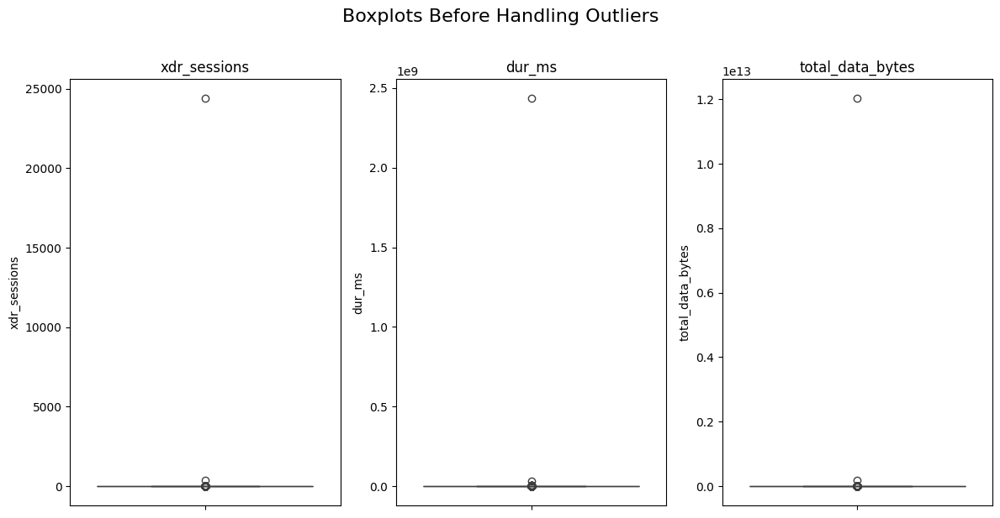

In [10]:
selected_columns = ['xdr_sessions', 'dur_ms', 'total_data_bytes']
plot_utls.plot_boxplots(df_user_engagement_df, selected_columns, 'Boxplots Before Handling Outliers')

In [11]:
df_user_engagement_df= cleaning_utils.fix_outliers(df_user_engagement_df)

2023-12-14 13:03:41,191:logger:Fix outliers
2023-12-14 13:03:41,216:logger:Fix outliers
2023-12-14 13:03:41,230:logger:Fix outliers


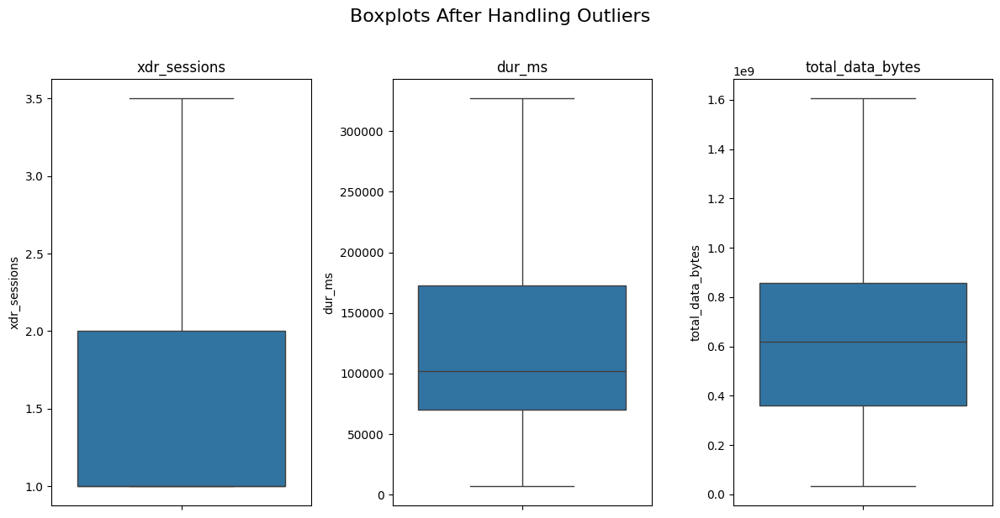

In [12]:
plot_utls.plot_boxplots(df_user_engagement_df, selected_columns, 'Boxplots After Handling Outliers')

#### Scaling Data

In [13]:
scaler_instance = StandardScaler()
scaled_data = scaler_instance.fit_transform(df_user_engagement_df)
scaled_data

array([[ 3.28881741,  2.32020199,  2.38118731],
       [-0.54939094, -1.05245656, -0.81904575],
       [-0.54939094, -0.88902168,  0.60013557],
       ...,
       [-0.54939094, -0.73035828, -0.46121225],
       [-0.54939094,  1.00239059, -0.67956342],
       [ 3.28881741,  2.32020199,  2.38118731]])

#### Normalize Data

In [14]:
normalized_data = normalize(scaled_data)
normalized_data

array([[ 0.70326378,  0.49614004,  0.50918083],
       [-0.38090376, -0.72968924, -0.56786084],
       [-0.45587466, -0.7376941 ,  0.49798164],
       ...,
       [-0.5366696 , -0.71344658, -0.45053271],
       [-0.41313151,  0.75377862, -0.51101874],
       [ 0.70326378,  0.49614004,  0.50918083]])

#### Cluster the normaized data (K=3)

In [15]:
kmeans = KMeans(n_clusters=3, random_state=1).fit(normalized_data)
kmeans.labels_

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


array([1, 0, 0, ..., 0, 2, 1], dtype=int32)

In [16]:
df_user_engagement_df.insert(0, 'cluster', kmeans.labels_)
df_user_engagement_df

,cluster,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,,
3.360167e+10,1,3.5,326892.5,1.604650e+09
3.360171e+10,0,1.0,38503.0,3.396170e+08
3.360171e+10,0,1.0,52478.0,9.006109e+08
3.360171e+10,1,2.0,120298.0,1.587337e+09
3.360171e+10,2,1.0,176022.0,1.783307e+08
...,...,...,...,...
3.370000e+10,2,1.0,171672.0,8.274129e+08
3.370000e+10,0,1.0,9498.0,5.844009e+08
3.370000e+10,0,1.0,66045.0,4.810664e+08


In [17]:
df_user_engagement_df['cluster'].value_counts()

0    45224
1    24189
2    20625
Name: cluster, dtype: int64

In [18]:
plot_utls.plot_scatter_cluster(df_user_engagement_df,
                            x_column='total_data_bytes',
                            y_column='dur_ms',
                            color_column='cluster',
                            size_column='xdr_sessions',
                            title='Scatter Plot of User Engagement Metrics')


In [19]:
plot_utls.plot_3d_scatter(df_user_engagement_df,
                                  x_column='total_data_bytes',
                                  y_column='dur_ms',
                                  z_column='xdr_sessions',
                                  color_column='cluster',
                                  rotation=[-1.5, -1.5, 1],
                                  title='3D Scatter Plot of User Engagement Metrics')

#### Compute minimum, maximum, average, and total non-normalized metrics for each cluster.

In [20]:
cluster_0 = df_user_engagement_df[df_user_engagement_df["cluster"]==0]
cluster_0[['xdr_sessions', 'dur_ms', 'total_data_bytes']].describe()

,xdr_sessions,dur_ms,total_data_bytes
count,45224.000000,45224.000000,4.522400e+04
mean,1.005948,66342.125531,5.004959e+08
std,0.076896,31431.564573,2.432972e+08
min,1.000000,7146.000000,3.324901e+07
25%,1.000000,34449.750000,2.920080e+08
50%,1.000000,83470.000000,5.036988e+08
75%,1.000000,86400.000000,7.106121e+08
max,2.000000,124696.000000,9.492921e+08


In [21]:
cluster_1 = df_user_engagement_df[df_user_engagement_df["cluster"]==1]
cluster_1[['xdr_sessions', 'dur_ms', 'total_data_bytes']].describe()

,xdr_sessions,dur_ms,total_data_bytes
count,24189.000000,24189.000000,2.418900e+04
mean,2.320290,208019.229950,1.116580e+09
std,0.548605,94689.490364,3.724623e+08
min,2.000000,21519.000000,1.418381e+08
25%,2.000000,129327.000000,8.369414e+08
50%,2.000000,199059.000000,1.119316e+09
75%,3.000000,316824.000000,1.467363e+09
max,3.500000,326892.500000,1.604650e+09


In [22]:
cluster_2 = df_user_engagement_df[df_user_engagement_df["cluster"]==2]
cluster_2[['xdr_sessions', 'dur_ms', 'total_data_bytes']].describe()

,xdr_sessions,dur_ms,total_data_bytes
count,20625.000000,20625.000000,2.062500e+04
mean,1.000679,171516.916885,4.890238e+08
std,0.026045,38724.214812,2.453615e+08
min,1.000000,114579.000000,3.357584e+07
25%,1.000000,140722.000000,2.762715e+08
50%,1.000000,162198.000000,4.854153e+08
75%,1.000000,189749.000000,7.019904e+08
max,2.000000,326892.500000,9.507607e+08


#### Total Traffic of Each Application Per User

In [27]:
df_telco_user_app_engagement_df = df[
    ['msisdn_number', 'social_media_total_bytes', 'google_total_bytes',
    'email_total_bytes', 'youtube_total_bytes', 'netflix_total_bytes',
    'gaming_total_bytes', 'other_total_bytes']]

In [29]:
df_telco_user_app_engagement_df = df_telco_user_app_engagement_df.groupby(
    'msisdn_number').sum()
df_telco_user_app_engagement_df.head()

,social_media_total_bytes,google_total_bytes,email_total_bytes,youtube_total_bytes,netflix_total_bytes,gaming_total_bytes,other_total_bytes
msisdn_number,,,,,,,
3.360167e+10,665487661.0,2.833355e+09,818423801.0,7.948124e+09,8.047787e+09,1.597187e+11,1.588765e+11
3.360171e+10,602474.0,1.344705e+07,2835412.0,2.541454e+07,1.247894e+07,2.830953e+08,7.861759e+08
3.360171e+10,3036290.0,4.379917e+06,3596083.0,1.651515e+07,1.695188e+07,8.397950e+08,6.824854e+08
3.360171e+10,4208402.0,2.115202e+07,3285166.0,6.737252e+07,5.976138e+07,1.423399e+09,1.326389e+09
3.360171e+10,2489630.0,1.309218e+07,3264827.0,2.297488e+07,2.487300e+07,1.102870e+08,8.259411e+07


##### Top 10 Engaged Users Per App

In [30]:
top_engaging_gaming = df_telco_user_app_engagement_df.nlargest(10, "gaming_total_bytes")['gaming_total_bytes']
top_engaging_netflix = df_telco_user_app_engagement_df.nlargest(10, "netflix_total_bytes")['netflix_total_bytes']
top_engaging_youtube = df_telco_user_app_engagement_df.nlargest(10, "youtube_total_bytes")['youtube_total_bytes']
top_engaging_email = df_telco_user_app_engagement_df.nlargest(10, "email_total_bytes")['email_total_bytes']
top_engaging_google = df_telco_user_app_engagement_df.nlargest(10, "google_total_bytes")['google_total_bytes']
top_engaging_social_media = df_telco_user_app_engagement_df.nlargest(10, "social_media_total_bytes")['social_media_total_bytes']
top_engaging_other = df_telco_user_app_engagement_df.nlargest(10, "other_total_bytes")['other_total_bytes']

In [31]:
top_engaging_gaming

msisdn_number
3.373458e+10    1.042597e+13
3.360167e+10    1.597187e+11
3.361489e+10    7.749432e+09
3.362578e+10    7.326673e+09
3.367588e+10    6.970568e+09
3.362632e+10    6.887572e+09
3.365973e+10    6.725559e+09
3.366646e+10    6.646303e+09
3.366471e+10    6.103856e+09
3.369879e+10    5.753743e+09
Name: gaming_total_bytes, dtype: float64

In [32]:
top_engaging_netflix

msisdn_number
3.373458e+10    5.532367e+11
3.360167e+10    8.047787e+09
3.365973e+10    3.995191e+08
3.361489e+10    3.614010e+08
3.362578e+10    3.569806e+08
3.362632e+10    3.287257e+08
3.366716e+10    3.139395e+08
3.367588e+10    3.090932e+08
3.369876e+10    2.808124e+08
3.369879e+10    2.682475e+08
Name: netflix_total_bytes, dtype: float64

#### Plot the top 3 most used applications using appropriate charts.

In [33]:
top_3 = df_telco_user_app_engagement_df.sum()
plot_utls.hist(top_3.nlargest(3))

#### Optimized Value of k for User Engagement k-means Clustering

In [35]:
distortions, inertias =  get_distortions_and_inertias(normalized_data, 20)

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/babi/anaconda3

In [36]:
plot_utls.elbow_method_plot(distortions, inertias)

AttributeError: 'PlotUtil' object has no attribute 'elbow_method_plot'

- Using the elbow method it is suggested that k = 4 is an optimal number of cluster

In [46]:
kmeans = KMeans(n_clusters=4, random_state=6).fit(normalized_data)
kmeans.labels_

/home/babi/anaconda3/envs/tenx_week1/lib/python3.12/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



array([0, 2, 3, ..., 2, 1, 0], dtype=int32)

In [47]:
df_user_engagement_df["cluster"]= kmeans.labels_
df_user_engagement_df

,cluster,xdr_sessions,dur_ms,total_data_bytes
msisdn_number,,,,
3.360167e+10,0,3.5,326892.5,1.604650e+09
3.360171e+10,2,1.0,38503.0,3.396170e+08
3.360171e+10,3,1.0,52478.0,9.006109e+08
3.360171e+10,0,2.0,120298.0,1.587337e+09
3.360171e+10,1,1.0,176022.0,1.783307e+08
...,...,...,...,...
3.370000e+10,1,1.0,171672.0,8.274129e+08
3.370000e+10,3,1.0,9498.0,5.844009e+08
3.370000e+10,2,1.0,66045.0,4.810664e+08


In [48]:
plot_utls.plot_scatter_cluster(df_user_engagement_df,
                            x_column='total_data_bytes',
                            y_column='dur_ms',
                            color_column='cluster',
                            size_column='xdr_sessions',
                            title='Scatter Plot of User Engagement Metrics')

In [50]:
plot_utls.plot_3d_scatter(df_user_engagement_df,
                                  x_column='total_data_bytes',
                                  y_column='dur_ms',
                                  z_column='xdr_sessions',
                                  color_column='cluster',
                                  rotation=[-1.5, -1.5, 1],
                                  title='3D Scatter Plot of User Engagement Metrics')

#### Save the user engagement dataframe

In [51]:
df_user_engagement_df.to_csv('../data/tellco_user_engagement_data.csv')

#### Save the mode as pickle

In [52]:
with open("../models/tellco_user_engagement.pkl", "wb") as f:
    pickle.dump(kmeans, f)